#### Ran on Windows 10 using Anaconda 3

## Loading Audio Files

In [630]:
import scipy.io.wavfile as scp_wav
from scipy.signal import resample, decimate
from IPython.display import Audio
import numpy as np
import matplotlib.pyplot as plt
import time

In [921]:
fs1, x1 = scp_wav.read('mic1.wav')
fs2, x2 = scp_wav.read('mic2.wav')
fs3, x3 = scp_wav.read('mic3.wav')
fs4, x4 = scp_wav.read('mic4.wav')
fs5, x5 = scp_wav.read('mic5.wav') 

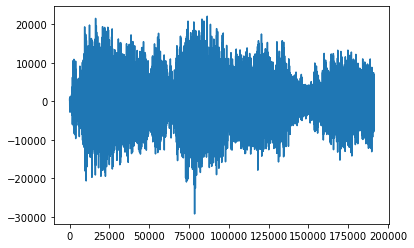

In [339]:
plt.plot(x1)

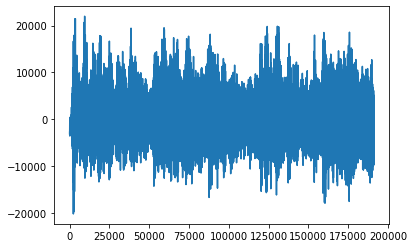

In [340]:
plt.plot(x2)

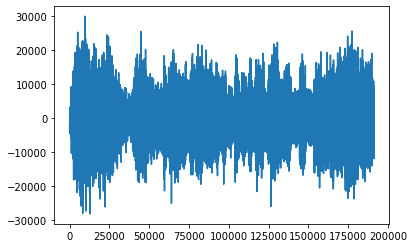

In [341]:
plt.plot(x3)

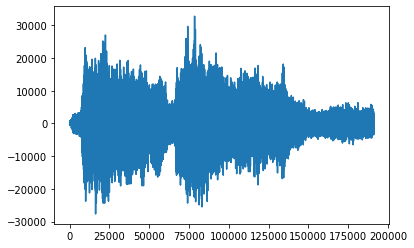

In [342]:
plt.plot(x4)

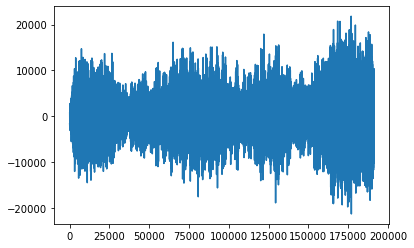

In [343]:
plt.plot(x5)

In [344]:
Audio('mic1.wav')

In [345]:
Audio('mic2.wav')

In [346]:
Audio('mic3.wav')

In [347]:
Audio('mic4.wav')

In [348]:
Audio('mic5.wav')

## Forming the signal matrix X

In [349]:
# concatenate the arrays
X = np.c_[x1, x2, x3, x4, x5]
np.max(X)

32767

## ICA

In [350]:
from sklearn.decomposition import FastICA

### Trial 1: Default parameters; logcosh function

Using the default sampling rate, and default FastICA parameters

In [359]:
transformer = FastICA(whiten=False)                

In [360]:
start = time.time()
Y = transformer.fit_transform(X)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.718235969543457  s.


Write the auido files

In [361]:
scp_wav.write(r'trial_1\y1_t1.wav', fs1, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write(r'trial_1\y2_t1.wav', fs1, Y[:,1].astype(np.int16))
scp_wav.write(r'trial_1\y3_t1.wav', fs1, Y[:,2].astype(np.int16))
scp_wav.write(r'trial_1\y4_t1.wav', fs1, Y[:,3].astype(np.int16))
scp_wav.write(r'trial_1\y5_t1.wav', fs1, Y[:,4].astype(np.int16))

In [362]:
Audio('trial_1\y1_t1.wav')

In [363]:
Audio('trial_1\y2_t1.wav')

In [364]:
Audio('trial_1\y3_t1.wav')

In [365]:
Audio('trial_1\y4_t1.wav')

In [366]:
Audio('trial_1\y5_t1.wav')

There is no discernable sepration among all signal sources. 

Mixing matrix

#### Reconstruct the sensor signals

In [367]:
X_recon = transformer.inverse_transform(Y)

#### Compute the residues

In [368]:
residue_t1 = np.zeros((5, len(x1)))

for index in range(5):
    residue_t1[index, :] = X[:, index] - X_recon[:, index]
    print('The residue for sensor signal', index+1, 'is: \n', residue_t1[index], '\n')

The residue for sensor signal 1 is: 
 [ 2.27373675e-13  2.27373675e-13  2.27373675e-13 ...  6.82121026e-13
  2.27373675e-13 -4.54747351e-13] 

The residue for sensor signal 2 is: 
 [4.54747351e-13 0.00000000e+00 4.54747351e-13 ... 0.00000000e+00
 4.54747351e-13 2.27373675e-13] 

The residue for sensor signal 3 is: 
 [ 0.00000000e+00 -4.54747351e-13 -4.54747351e-13 ... -4.54747351e-13
 -5.11590770e-13  0.00000000e+00] 

The residue for sensor signal 4 is: 
 [-5.51381163e-12 -7.04858394e-12 -6.36646291e-12 ... -5.57065505e-12
 -2.61479727e-12 -4.54747351e-13] 

The residue for sensor signal 5 is: 
 [-9.09494702e-13 -1.36424205e-12 -1.36424205e-12 ...  0.00000000e+00
 -4.54747351e-13  2.27373675e-13] 



### Trial 2: With Centering; logcosh function

Using same sampling rate, default parameters of ICA but with centering

#### Introduce centering

In [369]:
x1_ = x1 - np.mean(x1)
x2_ = x2 - np.mean(x2)
x3_ = x3 - np.mean(x3)
x4_ = x4 - np.mean(x4)
x5_ = x5 - np.mean(x5)

#### Form the new signal matrix

In [370]:
X_cent = np.c_[x1_, x2_, x3_, x4_, x5_]

#### ICA

In [371]:
transformer = FastICA(whiten=False)  

In [372]:
start = time.time()
Y = transformer.fit_transform(X_cent)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.9808261394500732  s.


Write the audio files

In [373]:
scp_wav.write('trial_2\y1_t2.wav', fs1, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('trial_2\y2_t2.wav', fs1, Y[:,1].astype(np.int16))
scp_wav.write('trial_2\y3_t2.wav', fs1, Y[:,2].astype(np.int16))
scp_wav.write('trial_2\y4_t2.wav', fs1, Y[:,3].astype(np.int16))
scp_wav.write('trial_2\y5_t2.wav', fs1, Y[:,4].astype(np.int16))

In [374]:
Audio('trial_2\y1_t2.wav')

In [375]:
Audio('trial_2\y2_t2.wav')

In [376]:
Audio('trial_2\y3_t2.wav')

In [377]:
Audio('trial_2\y4_t2.wav')

In [378]:
Audio('trial_2\y5_t2.wav')

With centering, no discernable separation is oberved.

#### Reconstruct the sensor signals

In [379]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [380]:
residue_t2 = np.zeros((5, len(x1)))

for index in range(5):
    residue_t2[index,:] = X_cent[:, index] - X_recon[:, index]
    #residue_m_t2[index] = np.mean(np.abs(residue))
    #print('The residue for sensor signal', index, 'is: \n', residue_m_t2[index], '\n')
    print('The residue for sensor signal', index, 'is: \n', residue_t2[index], '\n')

The residue for sensor signal 0 is: 
 [-2.27373675e-13  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
  0.00000000e+00 -2.27373675e-13] 

The residue for sensor signal 1 is: 
 [-8.64019967e-12 -1.09139364e-11 -9.54969437e-12 ... -6.36646291e-12
 -2.27373675e-12  4.54747351e-13] 

The residue for sensor signal 2 is: 
 [ 4.54747351e-12  5.45696821e-12  5.45696821e-12 ...  2.95585778e-12
  7.10542736e-13 -3.41060513e-13] 

The residue for sensor signal 3 is: 
 [-1.47792889e-12 -1.93267624e-12 -1.30739863e-12 ... -5.68434189e-12
 -4.32009983e-12 -2.50111043e-12] 

The residue for sensor signal 4 is: 
 [3.86535248e-12 5.00222086e-12 4.77484718e-12 ... 2.72848411e-12
 4.54747351e-13 0.00000000e+00] 



Very small residue

### Trial 3: With centering and whitening; logcosh function

In [884]:
# concatenate the arrays
X = np.c_[x1, x2, x3, x4, x5]
np.max(X)

522

In [885]:
X_ = X/32767  #normalize the data

#### ICA

In [886]:
transformer = FastICA()  

In [887]:
start = time.time()
Y = transformer.fit_transform(X_)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.3858301639556885  s.


In [888]:
Y=Y*32767  #revert to the original amplitude
Y.shape

(191258, 5)

Write the audio files

In [889]:
scp_wav.write('trial_3\y1_t2.wav', fs1, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('trial_3\y2_t2.wav', fs1, Y[:,1].astype(np.int16))
scp_wav.write('trial_3\y3_t2.wav', fs1, Y[:,2].astype(np.int16))
scp_wav.write('trial_3y4_t2.wav', fs1, Y[:,3].astype(np.int16))
scp_wav.write('trial_3\y5_t2.wav', fs1, Y[:,4].astype(np.int16))

In [890]:
Audio('trial_3\y1_t2.wav')

In [891]:
Audio('trial_3\y2_t2.wav')

In [892]:
Audio('trial_3\y3_t2.wav')

In [893]:
Audio('trial_3\y4_t2.wav')

In [894]:
Audio('trial_3\y5_t2.wav')

With centering and whitening, the signal sources have been succesfully separated. The only problem is the attenuation of the aplitude that 4 of the 5 sources have practically become silent. A solution is found by first normalizing the audio before ICA. The output was then multiplied by the normalizing factor. The audios can be heard albeit with lower amplitude than the original 'mixed' audio.

#### Reconstruct the sensor signals

In [531]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [532]:
residue_t3 = np.zeros((5, len(x1)))

for index in range(5):
    residue_t3[index,:] = X[:, index] - X_recon[:, index]
    #residue_m_t2[index] = np.mean(np.abs(residue))
    #print('The residue for sensor signal', index, 'is: \n', residue_m_t2[index], '\n')
    print('The residue for sensor signal', index, 'is: \n', residue_t3[index], '\n')

The residue for sensor signal 0 is: 
 [-0.00022482 -0.00022482 -0.00022482 ... -0.00022482 -0.00022482
 -0.00022482] 

The residue for sensor signal 1 is: 
 [-0.0007006 -0.0007006 -0.0007006 ... -0.0007006 -0.0007006 -0.0007006] 

The residue for sensor signal 2 is: 
 [-0.00041827 -0.00041827 -0.00041827 ... -0.00041827 -0.00041827
 -0.00041827] 

The residue for sensor signal 3 is: 
 [2.09135204e-05 2.09135204e-05 2.09135204e-05 ... 2.09135197e-05
 2.09135195e-05 2.09135195e-05] 

The residue for sensor signal 4 is: 
 [-0.00012548 -0.00012548 -0.00012548 ... -0.00012548 -0.00012548
 -0.00012548] 



With the satisfactory results of ICA with centering and whitening, it is, therefore, necessary, to have both preprocessing applied to audio before ICA.

### Trial 4: With centering and whitening; exp function

In [533]:
# concatenate the arrays
X = np.c_[x1, x2, x3, x4, x5]
np.max(X)

32767

In [534]:
X_ = X/32767  #normalize the data

#### ICA

In [535]:
transformer = FastICA(fun='exp')  

In [536]:
start = time.time()
Y = transformer.fit_transform(X_)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.43604254722595215  s.


In [537]:
Y=Y*32767  #revert to the original amplitude
Y.shape

(191258, 5)

Write the audio files

In [538]:
scp_wav.write('trial_4\y1_t2.wav', fs1, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('trial_4\y2_t2.wav', fs1, Y[:,1].astype(np.int16))
scp_wav.write('trial_4\y3_t2.wav', fs1, Y[:,2].astype(np.int16))
scp_wav.write('trial_4y4_t2.wav', fs1, Y[:,3].astype(np.int16))
scp_wav.write('trial_4\y5_t2.wav', fs1, Y[:,4].astype(np.int16))

In [539]:
Audio('trial_4\y1_t2.wav')

In [540]:
Audio('trial_4\y2_t2.wav')

In [541]:
Audio('trial_4\y3_t2.wav')

In [542]:
Audio('trial_4\y4_t2.wav')

In [543]:
Audio('trial_4\y5_t2.wav')

The same problem of amplitude attenuation still exists.

#### Reconstruct the sensor signals

In [544]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [545]:
residue_t4 = np.zeros((5, len(x1)))

for index in range(5):
    residue_t4[index,:] = X[:, index] - X_recon[:, index]
    #residue_m_t2[index] = np.mean(np.abs(residue))
    #print('The residue for sensor signal', index, 'is: \n', residue_m_t2[index], '\n')
    print('The residue for sensor signal', index, 'is: \n', residue_t4[index], '\n')

The residue for sensor signal 0 is: 
 [-0.00022482 -0.00022482 -0.00022482 ... -0.00022482 -0.00022482
 -0.00022482] 

The residue for sensor signal 1 is: 
 [-0.0007006 -0.0007006 -0.0007006 ... -0.0007006 -0.0007006 -0.0007006] 

The residue for sensor signal 2 is: 
 [-0.00041827 -0.00041827 -0.00041827 ... -0.00041827 -0.00041827
 -0.00041827] 

The residue for sensor signal 3 is: 
 [2.09135196e-05 2.09135193e-05 2.09135194e-05 ... 2.09135189e-05
 2.09135196e-05 2.09135205e-05] 

The residue for sensor signal 4 is: 
 [-0.00012548 -0.00012548 -0.00012548 ... -0.00012548 -0.00012548
 -0.00012548] 



Residue difference

In [546]:
np.mean(residue_t3**2) - np.mean(residue_t4**2)

1.2198333231645993e-18

Time difference

In [547]:
0.41193604469299316  - 0.43604254722595215 #logscoh - exp

-0.024106502532958984

### Trial 5: With centering and whitening; cube function

In [613]:
# concatenate the arrays
X = np.c_[x1, x2, x3, x4, x5]
np.max(X)

32767

In [614]:
X_ = X/32767  #normalize the data

#### ICA

In [550]:
transformer = FastICA(fun='cube')  

In [551]:
start = time.time()
Y = transformer.fit_transform(X_)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.535916805267334  s.


In [552]:
Y=Y*32767  #revert to the original amplitude
Y.shape

(191258, 5)

Write the audio files

In [553]:
scp_wav.write('trial_5\y1_t2.wav', fs1, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('trial_5\y2_t2.wav', fs1, Y[:,1].astype(np.int16))
scp_wav.write('trial_5\y3_t2.wav', fs1, Y[:,2].astype(np.int16))
scp_wav.write('trial_5\y4_t2.wav', fs1, Y[:,3].astype(np.int16))
scp_wav.write('trial_5\y5_t2.wav', fs1, Y[:,4].astype(np.int16))

In [554]:
Audio('trial_5\y1_t2.wav')

In [555]:
Audio('trial_5\y2_t2.wav')

In [556]:
Audio('trial_5\y3_t2.wav')

In [557]:
Audio('trial_5\y4_t2.wav')

In [558]:
Audio('trial_5\y5_t2.wav')

The same problem of attenuation still exists.

#### Reconstruct the sensor signals

In [559]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [560]:
residue_t5 = np.zeros((5, len(x1)))

for index in range(5):
    residue_t5[index,:] = X[:, index] - X_recon[:, index]
    #residue_m_t2[index] = np.mean(np.abs(residue))
    #print('The residue for sensor signal', index, 'is: \n', residue_m_t2[index], '\n')
    print('The residue for sensor signal', index, 'is: \n', residue_t5[index], '\n')

The residue for sensor signal 0 is: 
 [-0.00022482 -0.00022482 -0.00022482 ... -0.00022482 -0.00022482
 -0.00022482] 

The residue for sensor signal 1 is: 
 [-0.0007006 -0.0007006 -0.0007006 ... -0.0007006 -0.0007006 -0.0007006] 

The residue for sensor signal 2 is: 
 [-0.00041827 -0.00041827 -0.00041827 ... -0.00041827 -0.00041827
 -0.00041827] 

The residue for sensor signal 3 is: 
 [2.09135192e-05 2.09135195e-05 2.09135195e-05 ... 2.09135181e-05
 2.09135187e-05 2.09135191e-05] 

The residue for sensor signal 4 is: 
 [-0.00012548 -0.00012548 -0.00012548 ... -0.00012548 -0.00012548
 -0.00012548] 



Residue difference

In [561]:
np.mean(residue_t3**2) - np.mean(residue_t5**2)

-2.1141412967875303e-19

In [563]:
np.mean(residue_t4**2) - np.mean(residue_t5**2)

-1.4312474528433523e-18

Time difference

In [566]:
0.41193604469299316  - 0.535916805267334 #logscoh - cube

-0.12398076057434082

In [565]:
 0.43604254722595215 - 0.535916805267334 #exp - cube

-0.09987425804138184

The mean-squared residue of the exp function is smaller by a very small amount. cube is also slower compared to the other two.

Since logcosh is faster and its reside is very much the same as exp, it is chosen as better.

### Using different sampling rate

### Trial 6: Downsampling by a factor of 2

#### Downsampling

In [895]:
fs = int(fs1/2)

In [896]:
x1_ = decimate(x1, 2)
x2_ = decimate(x2, 2)
x3_ = decimate(x3, 2)
x4_ = decimate(x4, 2)
x5_ = decimate(x5, 2)

In [897]:
# concatenate the arrays
X_ = np.c_[x1_, x2_, x3_, x4_, x5_]

In [898]:
X_ = X_/32767  #normalize the data

#### ICA

In [899]:
transformer = FastICA()  

In [900]:
start = time.time()
Y = transformer.fit_transform(X_)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.18883323669433594  s.


In [901]:
Y=Y*32767  #revert to the original amplitude
Y.shape

(95629, 5)

Write the audio files

In [902]:
scp_wav.write('trial_6\y1_t6.wav', fs, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('trial_6\y2_t6.wav', fs, Y[:,1].astype(np.int16))
scp_wav.write('trial_6\y3_t6.wav', fs, Y[:,2].astype(np.int16))
scp_wav.write('trial_6\y4_t6.wav', fs, Y[:,3].astype(np.int16))
scp_wav.write('trial_6\y5_t6.wav', fs, Y[:,4].astype(np.int16))

In [903]:
Audio('trial_6\y1_t6.wav')

In [904]:
Audio('trial_6\y2_t6.wav')

In [905]:
Audio('trial_6\y3_t6.wav')

In [906]:
Audio('trial_6\y4_t6.wav')

In [907]:
Audio('trial_6\y5_t6.wav')

It sounds the same as the original sampling rate but the ICA computation is much faster

#### Reconstruct the sensor signals

In [908]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [909]:
residue_t6 = np.zeros((5, len(x1_)))

for index in range(5):
    residue_t6[index,:] = X_[:, index]*32767 - X_recon[:, index]
    #residue_m_t2[index] = np.mean(np.abs(residue))
    #print('The residue for sensor signal', index, 'is: \n', residue_m_t2[index], '\n')
    print('The residue for sensor signal', index, 'is: \n', residue_t6[index], '\n')

The residue for sensor signal 0 is: 
 [-0.02320778 -0.02320778 -0.02320778 ... -0.02320778 -0.02320778
 -0.02320778] 

The residue for sensor signal 1 is: 
 [0.00117797 0.00117797 0.00117797 ... 0.00117797 0.00117797 0.00117797] 

The residue for sensor signal 2 is: 
 [-0.00140582 -0.00140582 -0.00140582 ... -0.00140582 -0.00140582
 -0.00140582] 

The residue for sensor signal 3 is: 
 [-0.00312707 -0.00312707 -0.00312707 ... -0.00312707 -0.00312707
 -0.00312707] 

The residue for sensor signal 4 is: 
 [0.00390218 0.00390218 0.00390218 ... 0.00390218 0.00390218 0.00390218] 



### Trial 7: Downsampling by a factor of 3

#### Downsampling

In [793]:
fs = int(fs1/3)

In [794]:
x1_ = decimate(x1, 3)
x2_ = decimate(x2, 3)
x3_ = decimate(x3, 3)
x4_ = decimate(x4, 3)
x5_ = decimate(x5, 3)

In [795]:
# concatenate the arrays
X_ = np.c_[x1_, x2_, x3_, x4_, x5_]

In [796]:
X_ = X_/32767  #normalize the data

#### ICA

In [797]:
transformer = FastICA()  

In [798]:
start = time.time()
Y = transformer.fit_transform(X_)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.12798070907592773  s.


In [799]:
Y=Y*32767  #revert to the original amplitude
Y.shape

(63753, 5)

Write the audio files

In [800]:
scp_wav.write('trial_7\y1_t7.wav', fs, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('trial_7\y2_t7.wav', fs, Y[:,1].astype(np.int16))
scp_wav.write('trial_7\y3_t7.wav', fs, Y[:,2].astype(np.int16))
scp_wav.write('trial_7\y4_t7.wav', fs, Y[:,3].astype(np.int16))
scp_wav.write('trial_7\y5_t7.wav', fs, Y[:,4].astype(np.int16))

In [801]:
Audio('trial_7\y1_t7.wav')

In [802]:
Audio('trial_7\y2_t7.wav')

In [803]:
Audio('trial_7\y3_t7.wav')

In [804]:
Audio('trial_7\y4_t7.wav')

In [805]:
Audio('trial_7\y5_t7.wav')

There is a noticeable degradation in the quality of sound relative to the original sampling rate. No further downsampling will be done.

#### Reconstruct the sensor signals

In [806]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [807]:
residue_t6 = np.zeros((5, len(x1_)))

for index in range(5):
    residue_t6[index,:] = X_[:, index]*32767 - X_recon[:, index]
    #residue_m_t2[index] = np.mean(np.abs(residue))
    #print('The residue for sensor signal', index, 'is: \n', residue_m_t2[index], '\n')
    print('The residue for sensor signal', index, 'is: \n', residue_t6[index], '\n')

The residue for sensor signal 0 is: 
 [0.00353013 0.00353013 0.00353013 ... 0.00353013 0.00353013 0.00353013] 

The residue for sensor signal 1 is: 
 [-0.01604366 -0.01604366 -0.01604366 ... -0.01604366 -0.01604366
 -0.01604366] 

The residue for sensor signal 2 is: 
 [-0.01309915 -0.01309915 -0.01309915 ... -0.01309915 -0.01309915
 -0.01309915] 

The residue for sensor signal 3 is: 
 [-0.00163606 -0.00163606 -0.00163606 ... -0.00163606 -0.00163606
 -0.00163606] 

The residue for sensor signal 4 is: 
 [-0.01142701 -0.01142701 -0.01142701 ... -0.01142701 -0.01142701
 -0.01142701] 



### Trial 8: Upsampling by a factor of 2

#### Upsampling

In [820]:
fs = int(fs1*2)

In [835]:
n = len(x1)*2
x1_ = resample(x1, n)
x2_ = resample(x2, n)
x3_ = resample(x3, n)
x4_ = resample(x4, n)
x5_ = resample(x5, n)

In [836]:
# concatenate the arrays
X_ = np.c_[x1_, x2_, x3_, x4_, x5_]

In [837]:
X_ = X_/32767  #normalize the data

#### ICA

In [838]:
transformer = FastICA()  

In [839]:
start = time.time()
Y = transformer.fit_transform(X_)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.9398536682128906  s.


In [840]:
Y=Y*32767  #revert to the original amplitude
Y.shape

(382516, 5)

Write the audio files

In [841]:
scp_wav.write('trial_8\y1_t8.wav', fs, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('trial_8\y2_t8.wav', fs, Y[:,1].astype(np.int16))
scp_wav.write('trial_8\y3_t8.wav', fs, Y[:,2].astype(np.int16))
scp_wav.write('trial_8\y4_t8.wav', fs, Y[:,3].astype(np.int16))
scp_wav.write('trial_8\y5_t8.wav', fs, Y[:,4].astype(np.int16))

In [842]:
Audio('trial_8\y1_t8.wav')

In [843]:
Audio('trial_8\y2_t8.wav')

In [844]:
Audio('trial_8\y3_t8.wav')

In [845]:
Audio('trial_8\y4_t8.wav')

In [846]:
Audio('trial_8\y5_t8.wav')

Qualitatively, ther is no improvement in the sound. The ICA took longer to finish relative to all trials. No upsampling will be made.

#### Reconstruct the sensor signals

In [806]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [807]:
residue_t6 = np.zeros((5, len(x1_)))

for index in range(5):
    residue_t6[index,:] = X_[:, index]*32767 - X_recon[:, index]
    #residue_m_t2[index] = np.mean(np.abs(residue))
    #print('The residue for sensor signal', index, 'is: \n', residue_m_t2[index], '\n')
    print('The residue for sensor signal', index, 'is: \n', residue_t6[index], '\n')

The residue for sensor signal 0 is: 
 [0.00353013 0.00353013 0.00353013 ... 0.00353013 0.00353013 0.00353013] 

The residue for sensor signal 1 is: 
 [-0.01604366 -0.01604366 -0.01604366 ... -0.01604366 -0.01604366
 -0.01604366] 

The residue for sensor signal 2 is: 
 [-0.01309915 -0.01309915 -0.01309915 ... -0.01309915 -0.01309915
 -0.01309915] 

The residue for sensor signal 3 is: 
 [-0.00163606 -0.00163606 -0.00163606 ... -0.00163606 -0.00163606
 -0.00163606] 

The residue for sensor signal 4 is: 
 [-0.01142701 -0.01142701 -0.01142701 ... -0.01142701 -0.01142701
 -0.01142701] 



### Final: Downsampling by a factor of 2 using logcosh, centering, and whitening

#### Downsampling

In [855]:
fs = int(fs1/2)

In [856]:
x1_ = decimate(x1, 2)
x2_ = decimate(x2, 2)
x3_ = decimate(x3, 2)
x4_ = decimate(x4, 2)
x5_ = decimate(x5, 2)

In [857]:
# concatenate the arrays
X_ = np.c_[x1_, x2_, x3_, x4_, x5_]

In [858]:
X_ = X_/32767  #normalize the data

#### ICA

In [859]:
transformer = FastICA()  

In [860]:
start = time.time()
Y = transformer.fit_transform(X_)
end = time.time()
print('Execution time is: ', end-start, ' s.')

Execution time is:  0.16597366333007812  s.


In [861]:
Y=Y*32767  #revert to the original amplitude
Y.shape

(95629, 5)

Write the audio files

In [862]:
scp_wav.write('shat[1].wav', fs, Y[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('shat[2].wav', fs, Y[:,1].astype(np.int16))
scp_wav.write('shat[3].wav', fs, Y[:,2].astype(np.int16))
scp_wav.write('shat[4].wav', fs, Y[:,3].astype(np.int16))
scp_wav.write('shat[5].wav', fs, Y[:,4].astype(np.int16))

In [863]:
Audio('shat[1].wav')

In [864]:
Audio('shat[2].wav')

In [865]:
Audio('shat[3].wav')

In [866]:
Audio('shat[4].wav')

In [868]:
Audio('shat[5].wav')

It sounds the same as the original sampling rate but the ICA computation is much faster

#### Reconstruct the sensor signals

In [871]:
X_recon = transformer.inverse_transform(Y)

#### Compute Residue

In [872]:
residue_t6 = np.zeros((5, len(x1_)))

for index in range(5):
    residue_t6[index,:] = X_[:, index]*32767 - X_recon[:, index]
    print('The residue for sensor signal', index, 'is: \n', residue_t6[index], '\n')

The residue for sensor signal 0 is: 
 [0.00562125 0.00562125 0.00562125 ... 0.00562125 0.00562125 0.00562125] 

The residue for sensor signal 1 is: 
 [-0.00669348 -0.00669348 -0.00669348 ... -0.00669348 -0.00669348
 -0.00669348] 

The residue for sensor signal 2 is: 
 [-0.01008534 -0.01008534 -0.01008534 ... -0.01008534 -0.01008534
 -0.01008534] 

The residue for sensor signal 3 is: 
 [-0.00201065 -0.00201065 -0.00201065 ... -0.00201065 -0.00201065
 -0.00201065] 

The residue for sensor signal 4 is: 
 [-0.00056836 -0.00056836 -0.00056836 ... -0.00056836 -0.00056836
 -0.00056836] 



#### Save reconstrcuted 'mixed' aduio

In [873]:
scp_wav.write('recon[1].wav', fs, X_recon[:,0].astype(np.int16))  # convert to int16 for wav files
scp_wav.write('recon[2].wav', fs, X_recon[:,1].astype(np.int16))
scp_wav.write('recon[3].wav', fs, X_recon[:,2].astype(np.int16))
scp_wav.write('recon[4].wav', fs, X_recon[:,3].astype(np.int16))
scp_wav.write('recon[5].wav', fs, X_recon[:,4].astype(np.int16))

In [876]:
Audio('recon[1].wav')

In [877]:
Audio('recon[2].wav')

In [878]:
Audio('recon[3].wav')

In [879]:
Audio('recon[4].wav')

In [880]:
Audio('recon[5].wav')

In [912]:
_,x1 = scp_wav.read('shat[1].wav')
_,x2 = scp_wav.read('shat[2].wav')
_,x3 = scp_wav.read('shat[3].wav')
_,x4 = scp_wav.read('shat[4].wav')
_,x5 = scp_wav.read('shat[5].wav')

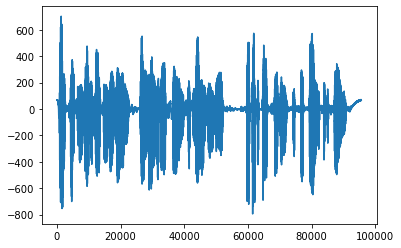

In [913]:
plt.plot(x1)

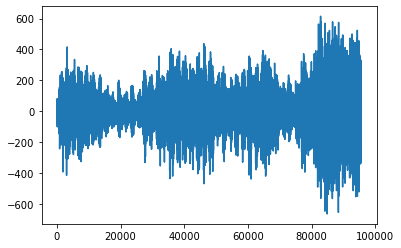

In [914]:
plt.plot(x2)

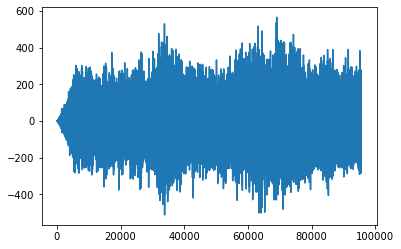

In [915]:
plt.plot(x3)

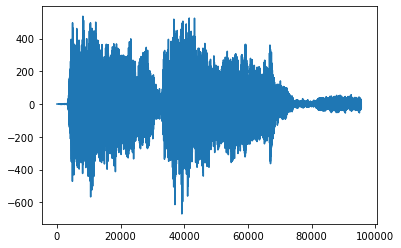

In [916]:
plt.plot(x4)

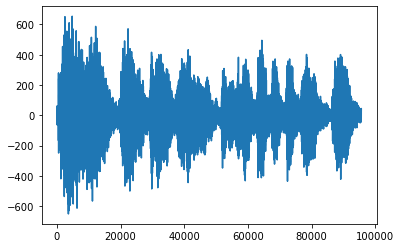

In [917]:
plt.plot(x5)